# Rt profile multicategorical versus uniform

In [1]:
# Import libraries
import os
import numpy as np
import math
import branchpro
import scipy.stats
from branchpro.apps import ReproductionNumberPlot
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import pandas as pd
from cmdstanpy import CmdStanModel, cmdstan_path
import arviz as az
import nest_asyncio
import seaborn as sns
nest_asyncio.apply()

num_timepoints = 100 # number of days for incidence data
num_categories = 2

/Users/ioaros/opt/anaconda3/envs/testbranchpro2/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# # Read contact matrix
# cm_file = 'UK'
# path = os.path.join('../data_library/contact_matrix', '{}.csv'.format(cm_file))
# contact_matrix = pd.read_csv(path, header=None)

# # Read serial interval
# si_file = 'si-epinow'
# path = os.path.join('../data_library/serial_interval', '{}.csv'.format(si_file))
# serial_interval = pd.read_csv(path, header=None)
# serial_interval = serial_interval.fillna(0)
# serial_intervals = serial_interval.values.T

# # Read transmissibility vector
# trans_file = 'UK'
# path = os.path.join('../data_library/transmissibility', '{}.csv'.format(trans_file))
# transmissibility = pd.read_csv(path, header=None)

In [3]:
# # Read Ontario data
# path = os.path.join('../data_library/covid_ontario/ON.csv')
# data = pd.read_csv(path)[:51]

## Parameterize example branching process model with disagregated data

In [4]:
# Build the serial interval w_s
ws_mean = 15.3
ws_var = 9.3**2
theta = ws_var / ws_mean
k = ws_mean / theta
w_dist = scipy.stats.gamma(k, scale=theta)
disc_w = w_dist.pdf(np.arange(num_timepoints))

# Simulate incidence data
initial_r = 1.2
serial_interval = disc_w

# contact_matrix = contact_matrix
contact_matrix = np.array([[8., 4.8], [1.2, 3.84]])
# contact_matrix = 1 * np.ones((2, 2))

transmissibility = [1, 0.5]
# transmissibility = [1.5, 1.5]

m = branchpro.MultiCatPoissonBranchProModel(
    initial_r, serial_interval, num_categories, contact_matrix, transmissibility)
new_rs = [0.5, 0.05, 0.2]          # sequence of R_0 numbers
start_times = [0, 30, 60]      # days at which each R_0 period begins
m.set_r_profile(new_rs, start_times)
parameters = [200, 20] # initial number of cases
times = np.arange(num_timepoints)

desagg_cases = m.simulate(parameters, times, var_contacts=True)
agg_cases = np.sum(desagg_cases, axis=1)

print(desagg_cases)

[[200.  20.]
 [  0.   0.]
 [  2.   0.]
 [  3.   0.]
 [ 27.   1.]
 [ 26.   5.]
 [ 30.   0.]
 [ 50.   9.]
 [ 53.   0.]
 [ 61.  11.]
 [ 86.   0.]
 [ 54.  15.]
 [108.   7.]
 [113.   3.]
 [ 91.  15.]
 [ 75.  65.]
 [126.  22.]
 [ 94.  55.]
 [140.   0.]
 [255.  26.]
 [124.  62.]
 [180.  48.]
 [274.  11.]
 [285.  43.]
 [336.  63.]
 [303.  41.]
 [286. 118.]
 [248.  22.]
 [306.  84.]
 [576.  83.]
 [841. 159.]
 [ 68.   3.]
 [ 94.   8.]
 [ 30.  10.]
 [ 40.   2.]
 [ 87.  12.]
 [105.  24.]
 [110.  22.]
 [107.  20.]
 [ 91.  18.]
 [124.  27.]
 [113.  27.]
 [ 65.  19.]
 [102.   2.]
 [119.  11.]
 [140.  28.]
 [112.  16.]
 [ 48.   8.]
 [ 91.   1.]
 [ 50.  16.]
 [ 82.  20.]
 [ 77.  14.]
 [ 41.  17.]
 [ 67.  11.]
 [ 53.  12.]
 [ 75.   0.]
 [ 63.   1.]
 [ 43.   9.]
 [ 58.   7.]
 [ 47.   5.]
 [ 37.  20.]
 [ 59.  90.]
 [248.  44.]
 [163.  45.]
 [149.  69.]
 [131.  37.]
 [ 69.  14.]
 [131.   6.]
 [135.   4.]
 [128.  29.]
 [240.  25.]
 [188.  39.]
 [128.  61.]
 [ 79.  69.]
 [234.   9.]
 [190.  31.]
 [328.  68.]

## Plot agreggated local incidence numbers

In [5]:
# Plot (bar chart cases each day)
fig = go.Figure()

# Plot of incidences
fig.add_trace(
    go.Bar(
        x=times,
        y=agg_cases,
        name='Incidences'
    )
)

# Add axis labels
fig.update_layout(
    xaxis_title='Time (days)',
    yaxis_title='New cases'
)

fig.show()

## R_t inference using STAN

In [6]:
# Same inference, but using the PoissonBranchProPosterior
tau = 6
R_t_start = tau+1
a = 1
b = 1/5
sigma = 1.5

# Correction for reproduction number per category
correc_i = np.multiply(np.sum(contact_matrix, axis=0), transmissibility)
correc_e = np.multiply(np.sum(m.exact_contact_matrix, axis=1), transmissibility)

In [7]:
# Transform our incidence data into pandas dataframes
multicat_inc_data_matrix = {'Time': np.arange(num_timepoints)}

for _ in range(num_categories):
    multicat_inc_data_matrix['Incidence Number Cat {}'.format(_+1)] = \
        desagg_cases[:, _]

multicat_inc_data = pd.DataFrame(multicat_inc_data_matrix)

# Transform our incidence data into pandas dataframes
inc_data = pd.DataFrame(
    {
        'Time': np.arange(num_timepoints),
        'Incidence Number': agg_cases
    }
)

L1 = len(np.arange(R_t_start, start_times[1]+1))
L2 = len(np.arange(start_times[1]+1, start_times[2]+1))
L3 = len(np.arange(start_times[2]+1, num_timepoints))

ground_truth = []
for j in range(num_categories):
    ground_truth.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'R_t': (0.5*correc_e[R_t_start:(start_times[1]+1), j]).tolist() + (0.05*correc_e[(start_times[1]+1):(start_times[2]+1), j]).tolist() + (0.2*correc_e[(start_times[2]+1):num_timepoints, j]).tolist()
    }))

## 1. Exact Contact data + Group-specific cases + Poisson Branching process with multiple categories

In [8]:
exact_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/exact_multicat.stan'))

exact_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': np.array(m.exact_contact_matrix),
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18880/3829575306.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [9]:
fit = exact_multicat_model.sample(
    data=exact_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:03:11 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status

chain 1 |▉         | 00:48 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 01:22 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 01:48 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 02:03 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |███▏      | 02:32 Iteration:  500 / 2000 [ 25%]  (Warmup)

chain 1 |███▋      | 02:46 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████▌     | 03:13 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▍    | 03:29 Iteration: 1000 / 2000 [ 50%]  (Warmup)

chain 1 |█████▉    | 03:40 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 03:52 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 04:04 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 04:16 Iteration: 1300 / 2000 [ 65%]  (Sampling)
chain 1 |███████▋  | 04:27 Iteration: 1400 / 2000 [ 70%]  (Sam


13:09:58 - cmdstanpy - INFO - CmdStan done processing.
13:09:58 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'exact_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.490,0.039,0.417,0.563,0.001,0.0,4735.0,2430.0,1.00
R[1],0.509,0.035,0.448,0.580,0.001,0.0,4026.0,2197.0,1.00
R[2],0.514,0.031,0.457,0.574,0.001,0.0,3564.0,2310.0,1.00
R[3],0.505,0.026,0.460,0.556,0.000,0.0,4098.0,2182.0,1.00
R[4],0.511,0.025,0.467,0.561,0.000,0.0,5224.0,2393.0,1.00
...,...,...,...,...,...,...,...,...,...
R[88],0.198,0.004,0.190,0.204,0.000,0.0,4673.0,1845.0,1.01
R[89],0.197,0.004,0.191,0.204,0.000,0.0,3691.0,2138.0,1.00
R[90],0.200,0.004,0.193,0.207,0.000,0.0,4102.0,2188.0,1.00
R[91],0.198,0.004,0.191,0.205,0.000,0.0,4202.0,2300.0,1.00


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

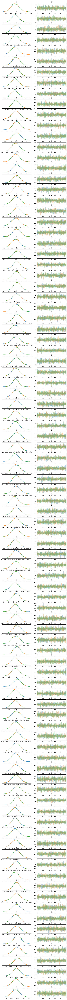

In [10]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [11]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
exact_multicat_intervals = []

for j in range(num_categories):
    exact_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], axis=0),
        'Lower bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(extended_samples[::thinning, :] * correc_e[R_t_start:, j][None, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 2. Average Contact data + Group-specific cases + Poisson Branching process with multiple categories

In [12]:
approx_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/approx_multicat.stan'))

approx_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': desagg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18880/2726440678.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [13]:
fit = approx_multicat_model.sample(data=approx_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:10:06 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▍         | 00:00 Status
chain 1 |▉         | 00:21 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 00:42 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 00:59 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 01:16 Iteration:  300 / 2000 [ 15%]  (Warmup)

chain 1 |██▋       | 01:33 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 01:47 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 02:03 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 02:17 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 02:30 Iteration:  800 / 2000 [ 40%]  (Warmup)

chain 1 |█████▉    | 02:57 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▊   | 03:20 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▋  | 03:44 Iteration: 1400 / 2000 [ 70%]  (Sampling)
chain 1 |████████▏ | 03:56 Iteration: 1500 / 2000 [ 75%]  (Sampli


13:16:07 - cmdstanpy - INFO - CmdStan done processing.
13:16:07 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'approx_multicat.stan', line 55, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive fin

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.503,0.040,0.435,0.584,0.001,0.0,4180.0,2091.0,1.0
R[1],0.505,0.036,0.436,0.569,0.001,0.0,4947.0,2248.0,1.0
R[2],0.534,0.033,0.468,0.594,0.000,0.0,4481.0,1772.0,1.0
R[3],0.575,0.030,0.518,0.630,0.000,0.0,4261.0,2075.0,1.0
R[4],0.546,0.027,0.496,0.595,0.000,0.0,4490.0,2426.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],0.209,0.004,0.201,0.216,0.000,0.0,5300.0,2479.0,1.0
R[89],0.212,0.004,0.204,0.219,0.000,0.0,3972.0,1913.0,1.0
R[90],0.208,0.004,0.201,0.215,0.000,0.0,4977.0,2112.0,1.0
R[91],0.213,0.004,0.205,0.219,0.000,0.0,4640.0,1994.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

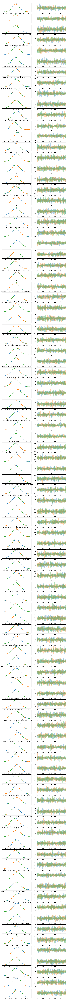

In [14]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [15]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
approx_multicat_intervals = []

for j in range(num_categories):
    approx_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 3. Average Contact data + Total cases + Poisson Branching process with multiple categories

In [16]:
agg_multicat_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/agg_multicat.stan'))

agg_multicat_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'n': num_categories,
    'C': contact_matrix,
    'transm': transmissibility,
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18880/3052504579.py:10: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [17]:
fit = agg_multicat_model.sample(data=agg_multicat_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:16:16 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status

chain 1 |▍         | 00:00 Status
chain 1 |▉         | 21:43 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 24:02 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 25:33 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 26:24 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 27:22 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 28:12 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |████      | 29:52 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 30:40 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████▍    | 31:43 Iteration: 1000 / 2000 [ 50%]  (Warmup)

chain 1 |█████▉    | 32:46 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 33:50 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 34:54 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 35:59 Iteration: 1300 / 2000 [ 65%]  (Sampli


13:58:58 - cmdstanpy - INFO - CmdStan done processing.
13:58:58 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_multicat.stan', line 58, column 8 to column 28)
Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'agg_mult

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],0.489,0.039,0.414,0.561,0.001,0.000,4988.0,1958.0,1.0
R[1],0.492,0.034,0.431,0.558,0.000,0.000,5959.0,2276.0,1.0
R[2],0.521,0.032,0.461,0.584,0.000,0.000,6031.0,2149.0,1.0
R[3],0.561,0.031,0.508,0.621,0.000,0.000,4978.0,2390.0,1.0
R[4],0.535,0.028,0.486,0.590,0.000,0.000,5367.0,2082.0,1.0
...,...,...,...,...,...,...,...,...,...
"p[97, 1]",0.539,0.285,0.077,1.000,0.004,0.003,5585.0,1720.0,1.0
"p[98, 0]",0.500,0.288,0.060,0.997,0.004,0.003,5088.0,1676.0,1.0
"p[98, 1]",0.500,0.288,0.003,0.940,0.004,0.003,5088.0,1676.0,1.0
"p[99, 0]",0.502,0.292,0.000,0.942,0.004,0.003,4688.0,1824.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

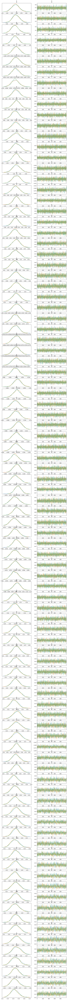

In [18]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

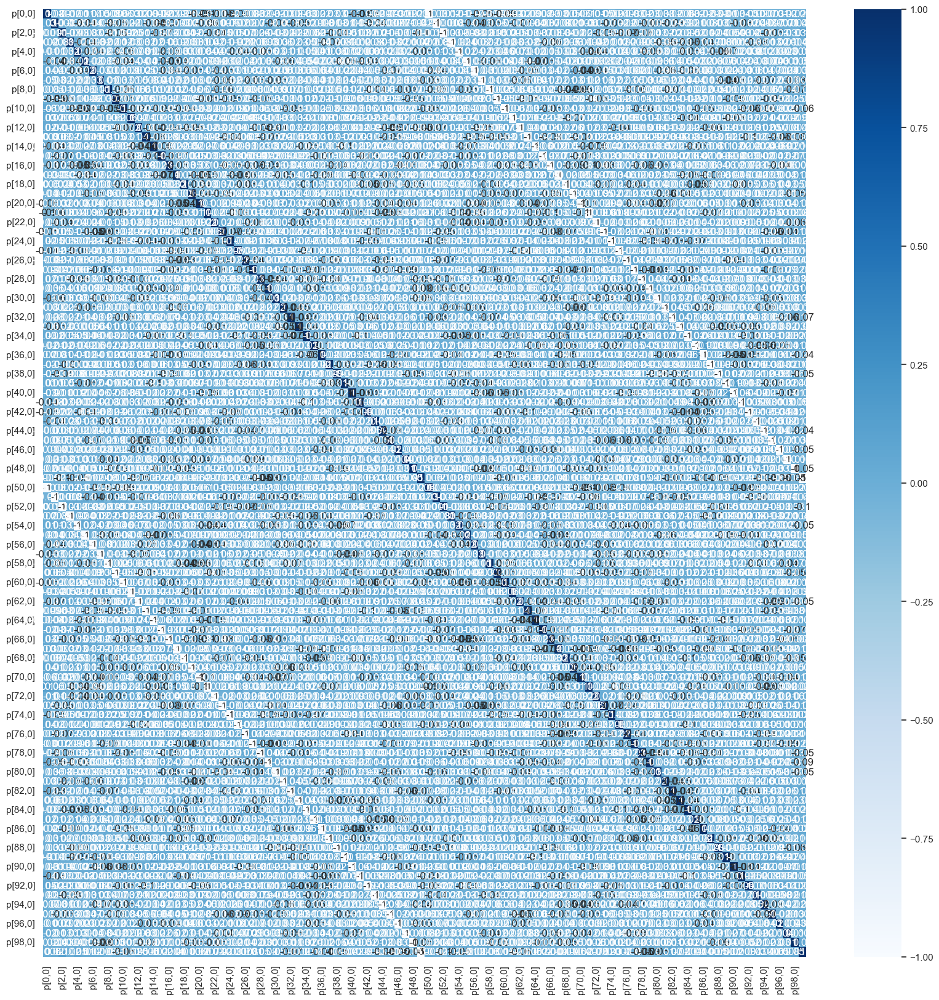

In [19]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
p_chain_samples = fit.draws()[500:, :, (num_timepoints - R_t_start +7)::num_categories]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = p_chain_samples.shape

extended_p_samples = np.concatenate((
    p_chain_samples[:, 0, :],
    p_chain_samples[:, 1, :],
    p_chain_samples[:, 2, :]), axis=0)

df = pd.DataFrame(
    extended_p_samples,
    columns=[
        'p[{},0]'.format(_)
        for _ in range(num_timepoints)])

plt.figure(figsize=(20,20))
sns.set_theme(style="white")
corr = df.corr()
heatmap = sns.heatmap(corr, annot=True, cmap="Blues", fmt='.1g')

In [20]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:(num_timepoints - R_t_start +7)]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))
agg_multicat_intervals = []

for j in range(num_categories):
    agg_multicat_intervals.append(pd.DataFrame({
        'Time Points': np.arange(R_t_start, num_timepoints),
        'Mean': np.mean(correc_i[j] * extended_samples[::thinning, :], axis=0),
        'Lower bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.025, axis=0),
        'Upper bound CI': np.quantile(correc_i[j] * extended_samples[::thinning, :], 0.975, axis=0),
        'Central Probability': (L1+L2+L3) * [0.95]
    }))

## 4. No Contact data + Total cases + Poisson Branching process

In [21]:
poisson_model = CmdStanModel(stan_file=os.path.join(
        '../../stan_models/poisson_one.stan'))

poisson_data = {
    'N': num_timepoints,
    'S': len(serial_interval),
    'I': agg_cases.astype(np.integer).tolist(),
    'tau': tau,
    'revSI': serial_interval.tolist()[::-1],
    'a': a,
    'b': b,
    'sigma': sigma}

/var/folders/ph/jyxnc9y52svgq2k5lt2q4r000000gp/T/ipykernel_18880/3414372969.py:7: DeprecationWarning:

Converting `np.integer` or `np.signedinteger` to a dtype is deprecated. The current result is `np.dtype(np.int_)` which is not strictly correct. Note that the result depends on the system. To ensure stable results use may want to use `np.int64` or `np.int32`.



In [22]:
fit = poisson_model.sample(
    data=poisson_data, seed=10, chains=3, iter_sampling=1000)

samples = az.from_cmdstanpy(fit)

az.summary(samples)

13:59:12 - cmdstanpy - INFO - CmdStan start processing
chain 1 |          | 00:00 Status
chain 1 |▉         | 00:00 Iteration:    1 / 2000 [  0%]  (Warmup)
chain 1 |█▎        | 00:01 Iteration:  100 / 2000 [  5%]  (Warmup)
chain 1 |█▊        | 00:01 Iteration:  200 / 2000 [ 10%]  (Warmup)
chain 1 |██▎       | 00:02 Iteration:  300 / 2000 [ 15%]  (Warmup)
chain 1 |██▋       | 00:02 Iteration:  400 / 2000 [ 20%]  (Warmup)
chain 1 |███▏      | 00:03 Iteration:  500 / 2000 [ 25%]  (Warmup)
chain 1 |███▋      | 00:03 Iteration:  600 / 2000 [ 30%]  (Warmup)
chain 1 |████      | 00:04 Iteration:  700 / 2000 [ 35%]  (Warmup)
chain 1 |████▌     | 00:04 Iteration:  800 / 2000 [ 40%]  (Warmup)
chain 1 |█████     | 00:05 Iteration:  900 / 2000 [ 45%]  (Warmup)
chain 1 |█████▉    | 00:05 Iteration: 1001 / 2000 [ 50%]  (Sampling)
chain 1 |██████▎   | 00:06 Iteration: 1100 / 2000 [ 55%]  (Sampling)
chain 1 |██████▊   | 00:06 Iteration: 1200 / 2000 [ 60%]  (Sampling)
chain 1 |███████▎  | 00:06 Iterati


13:59:22 - cmdstanpy - INFO - CmdStan done processing.
13:59:22 - cmdstanpy - WARNING - Non-fatal error during sampling:
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is 0, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'poisson_one.stan', line 45, column 8 to column 28)
	Exception: gamma_lpdf: Random variable is inf, but must be positive finite! (in 'po

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
R[0],4.388,0.348,3.713,5.024,0.005,0.004,4401.0,2222.0,1.0
R[1],4.411,0.304,3.887,5.029,0.005,0.004,3603.0,2113.0,1.0
R[2],4.673,0.284,4.136,5.190,0.005,0.003,3932.0,2261.0,1.0
R[3],5.027,0.270,4.504,5.527,0.005,0.003,3502.0,2318.0,1.0
R[4],4.785,0.245,4.320,5.244,0.004,0.003,3848.0,2344.0,1.0
...,...,...,...,...,...,...,...,...,...
R[88],1.730,0.033,1.664,1.787,0.001,0.000,3817.0,2020.0,1.0
R[89],1.764,0.033,1.699,1.825,0.001,0.000,3850.0,2496.0,1.0
R[90],1.738,0.031,1.680,1.794,0.000,0.000,3870.0,1996.0,1.0
R[91],1.785,0.032,1.726,1.842,0.000,0.000,4417.0,2070.0,1.0


array([[<Axes: title={'center': 'R\n0'}>,
        <Axes: title={'center': 'R\n0'}>],
       [<Axes: title={'center': 'R\n1'}>,
        <Axes: title={'center': 'R\n1'}>],
       [<Axes: title={'center': 'R\n2'}>,
        <Axes: title={'center': 'R\n2'}>],
       [<Axes: title={'center': 'R\n3'}>,
        <Axes: title={'center': 'R\n3'}>],
       [<Axes: title={'center': 'R\n4'}>,
        <Axes: title={'center': 'R\n4'}>],
       [<Axes: title={'center': 'R\n5'}>,
        <Axes: title={'center': 'R\n5'}>],
       [<Axes: title={'center': 'R\n6'}>,
        <Axes: title={'center': 'R\n6'}>],
       [<Axes: title={'center': 'R\n7'}>,
        <Axes: title={'center': 'R\n7'}>],
       [<Axes: title={'center': 'R\n8'}>,
        <Axes: title={'center': 'R\n8'}>],
       [<Axes: title={'center': 'R\n9'}>,
        <Axes: title={'center': 'R\n9'}>],
       [<Axes: title={'center': 'R\n10'}>,
        <Axes: title={'center': 'R\n10'}>],
       [<Axes: title={'center': 'R\n11'}>,
        <Axes: title

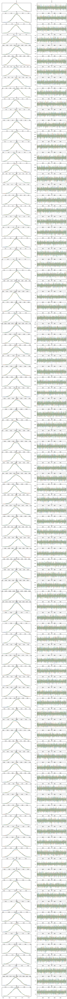

In [23]:
az.rcParams['plot.max_subplots'] = 2*(num_timepoints - R_t_start)

az.plot_trace(
    samples,
    var_names=('R'),
    filter_vars='like',
    compact=False)

In [24]:
# Eliminate burn-in iterations (1/2 of the chain lengths)
chain_samples = fit.draws()[500:, :, 7:]

# Evaluate the model for all parameter sets in the samples
n_param, n_sample, n_chains = chain_samples.shape

extended_samples = np.concatenate((
    chain_samples[:, 0, :],
    chain_samples[:, 1, :],
    chain_samples[:, 2, :]), axis=0)

thinning = max(1, int(n_sample * n_chains / 500))

pois_intervals = pd.DataFrame({
    'Time Points': np.arange(R_t_start, num_timepoints),
    'Mean': np.mean(extended_samples[::thinning, :], axis=0),
    'Lower bound CI': np.quantile(extended_samples[::thinning, :], 0.025, axis=0),
    'Upper bound CI': np.quantile(extended_samples[::thinning, :], 0.975, axis=0),
    'Central Probability': (L1+L2+L3) * [0.95]
})

## Inference plot using class method results

In [25]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.65,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1,
            itemwidth=50
        )
)

fig.figure.write_image('images/Figure 3.pdf')

fig.show_figure()

/Users/ioaros/Desktop/Software Project/branchpro/branchpro/apps/_reproduction_number_plot.py:27: UserWarning:

Labels do not match. They will be updated.



In [26]:
fig = ReproductionNumberPlot()

j=0
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One-group model'
   
fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 3 Perfect.pdf')

fig.show_figure()

In [27]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(approx_multicat_intervals[j], colour='red', model_type='<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Group-specific cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(agg_multicat_intervals[j], colour='orange', model_type='<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[3]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Total cases + Average C<sub>t</sub> data<br>Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[5]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(3):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.65,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4.pdf')

fig.show_figure()

In [28]:
fig = ReproductionNumberPlot()

j=1
fig.add_ground_truth_rt(ground_truth[j])
fig.figure.data[0]['name'] = 'True R<sup>({})</sup><sub>t</sub>'.format(j+1)

fig.add_interval_rt(exact_multicat_intervals[j], colour='mediumvioletred', model_type='<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1))
fig.figure.data[1]['name'] = 'Estimated R<sup>({})</sup><sub>t</sub> Exact C<sub>t</sub> data Multiple-group model'.format(j+1)

fig.add_interval_rt(pois_intervals, colour='deepskyblue', model_type='One-group model')
fig.figure.data[3]['name'] = 'Estimated R<sub>t</sub> One-group model'

fig.update_labels(time_label='Time (days)', r_label='Reproduction number R<sub>t</sub>')

for i in range(2):
        fig.figure['data'][2*(i+1)]['showlegend'] = False

fig.figure.add_hline(
    y=1, line_dash='dot',
    annotation_text='R<sub>t</sub>=1', fillcolor='black',
    annotation_position='bottom left')

fig.figure.update_layout(
    width=900, 
    height=600,
    plot_bgcolor='white',
    font=dict(
            size=16),
    xaxis=dict(
        linecolor='black'),
    yaxis=dict(
        linecolor='black',
        range=[0, 8]),
    legend=dict(
            orientation="h",
            yanchor="bottom",
            y=0.8,
            xanchor="right",
            x=1.05,
            bordercolor="Black",
            borderwidth=1
        )
)

fig.figure.write_image('images/Figure 4 Perfect.pdf')

fig.show_figure()